# Анализируем фотоальбом

In [90]:
from PIL import Image
import os
from glob import glob

### Загружаем изображения с диска

Мы можем загрузить изображения с локального диска на Google Colab, создав вручную папку `images` и перетащив изображения туда. В этом случае можем загрузить все изображения в память так:

In [92]:
images = []
for f in glob('images/*'):
  image = Image.open(f)
  images.append(image)

Опишем универсальную функцию для показа списка изображений:

In [93]:
import matplotlib.pyplot as plt

def display_images(l,titles=None,fontsize=12):
    n=len(l)
    fig,ax = plt.subplots(1,n)
    for i,im in enumerate(l):
        ax[i].imshow(im)
        ax[i].axis('off')
        if titles is not None:
            ax[i].set_title(titles[i],fontsize=fontsize)
    fig.set_size_inches(fig.get_size_inches()*n)
    plt.tight_layout()
    plt.show()

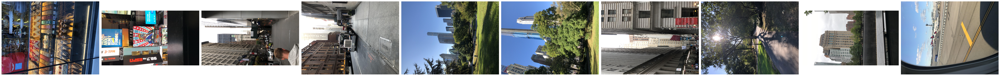

In [94]:
display_images(images[:10])

### Загружаем изображения с сайта

В качестве альтернативы можем загрузить изображения с некоторой веб-странички, например, [отсюда](https://t-j.ru/photoalbum-new-york-2019). Прочитаем сам текст странички:

'<!DOCTYPE html><html lang="ru" prefix="og: http://ogp.me/ns# article: http://ogp.me/ns/article# fb: http://ogp.me/ns/fb#"><head>  <meta charset="utf-8">   <meta name="viewport" content="width=device-width,initial-scale=1,viewport-fit=cover">   <meta name="format-detection" content="telephone=no">  <meta name="referrer" content="no-referrer-when-downgrade">  <link rel="manifest" href="https://static2.tinkoffjournal.ru/manifests/manifest.json">  <link rel="alternate" type="application/rss+xml" href="/feed/"><link rel="alternate" type="application/atom+xml" href="/feed/atom/">  <link rel="canonical" href="https://t-j.ru/photoalbum-new-york-2019/">  <link rel="dns-prefetch" href="https://static2.tinkoffjournal.ru"><link rel="dns-prefetch" href="https://opis-cdn.tinkoffjournal.ru">  <link rel="dns-prefetch" href="https://img-cdn.tinkoffjournal.ru"><link rel="dns-prefetch" href="https://mc.yandex.ru">  <link rel="preconnect" href="https://static2.tinkoffjournal.ru" crossorigin><link rel="pr
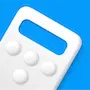
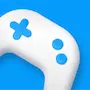
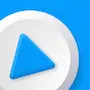
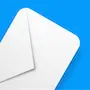

In [95]:
import requests

page = requests.get("https://t-j.ru/photoalbum-new-york-2019").text
page

Можем видеть, что все ссылки на изображения имеют определённый шаблон. Выделим их из текста с помощью регулярных выражений:

In [97]:
import re
l = re.findall("\"(https://opis-cdn.tinkoffjournal.ru/mercury/.*?)\"",page)
l = set([x.split('?')[0].split(' ')[0] for x in l if 'jpeg' in x])
l

{'https://opis-cdn.tinkoffjournal.ru/mercury/064c9f84.26441de0_eac91e6d_2a4c_4057_b1d6_2a73d595a5a2.jpeg',
 'https://opis-cdn.tinkoffjournal.ru/mercury/077b5988.9248ccdf_img_5768.jpeg',
 'https://opis-cdn.tinkoffjournal.ru/mercury/10feb6db.bd7ad93a_img_5770.jpeg',
 'https://opis-cdn.tinkoffjournal.ru/mercury/15e1a28f.55d8015e_5c850044_384b_441f_b4cb_1efb4d856a99.jpeg',
 'https://opis-cdn.tinkoffjournal.ru/mercury/1c8a7d33.b72c55c1_img_5795.jpeg',
 'https://opis-cdn.tinkoffjournal.ru/mercury/207b0947.9063035b_a4612dc3_c5ce_40b6_97c3_e1a2ebbe6c06.jpeg',
 'https://opis-cdn.tinkoffjournal.ru/mercury/3197da7c.db05734e_img_5759.jpeg',
 'https://opis-cdn.tinkoffjournal.ru/mercury/31d02f6a.5b332eb6_7eb429e7_8b49_4909_b4ac_721f56cd6f44.jpeg',
 'https://opis-cdn.tinkoffjournal.ru/mercury/353d648d.36a6a33b_img_5796.jpeg',
 'https://opis-cdn.tinkoffjournal.ru/mercury/42b73a5d.d67735c2_img_5766.jpeg',
 'https://opis-cdn.tinkoffjournal.ru/mercury/470edc16.a43c5771_img_5761.jpeg',
 'https://opis-cdn.

Теперь загружаем все изображения прямо через интернет (код для этого легко находится в интернете):

In [98]:
from PIL import Image
import requests
from io import BytesIO
from tqdm.auto import tqdm

def load_image(url):
  response = requests.get(url)
  return Image.open(BytesIO(response.content))

images = []
for x in tqdm(l):
  images.append(load_image(x))

  0%|          | 0/29 [00:00<?, ?it/s]

Вне зависимости от способа получения изображений - масштабируем их до маленького размера и (в случае необходимости) повернём:

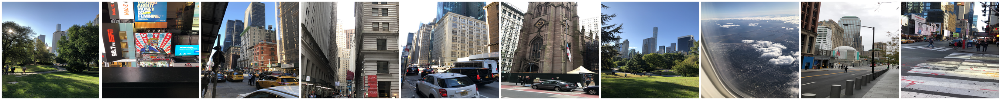

In [101]:
ims = [ np.array(i.resize((224,224),Image.Resampling.LANCZOS).rotate(270)) for i in images]
display_images(ims[:10])

### Классификация изображений предобученной сетью

Используем предобученную модель VGG-16 для классификации изображений. Опишем функцию, которая возвращает имя класса:

In [108]:
import tensorflow as tf
import numpy as np

vgg = tf.keras.applications.VGG16()

def classify(x):
  x = tf.keras.applications.vgg16.preprocess_input(x)
  x = np.expand_dims(x, axis=0)
  res = vgg(x)
  return tf.keras.applications.vgg16.decode_predictions(res)[0][0][1]

res = classify(ims[0])
res

'obelisk'

Теперь обработаем все изображения:

In [109]:
res = []
for x in tqdm(ims):
  res.append(classify(x))

  0%|          | 0/29 [00:00<?, ?it/s]

И покажем изображения вместе с классами:

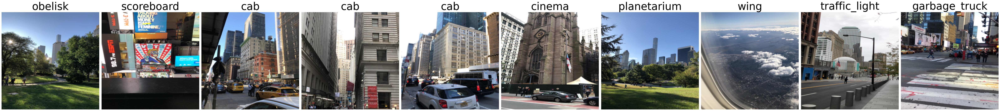

In [111]:
display_images(ims[:10],titles=res[:10],fontsize=48)

> Обратите внимание, что для наглядности мы обрабатываем изображения по-одиночке в цикле. Однако, мы могли бы объединить все изображение в один минибатч, и вызвать сеть сразу на всех изображениях. Так мы будем действовать ниже.

### Кластеризация изображений

Для кластеризации нам нужно извлечь из изображений смысловые или описательные вектора. Посмотрим, какие есть слои в VGG-16:

In [112]:
vgg.summary()

Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_9 (InputLayer)           │ (None, 224, 224, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv1 (Conv2D)                │ (None, 224, 224, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_conv2 (Conv2D)                │ (None, 224, 224, 64)        │          36,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block1_pool (MaxPooling2D)           │ (None, 112, 112, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv1 (Conv2D)                │ (None, 112, 112, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_conv2 (Conv2D)                │ (None, 112, 112, 128)       │         147,584 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block2_pool (MaxPooling2D)           │ (None, 56, 56, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv1 (Conv2D)                │ (None, 56, 56, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv2 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_conv3 (Conv2D)                │ (None, 56, 56, 256)         │         590,080 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block3_pool (MaxPooling2D)           │ (None, 28, 28, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv1 (Conv2D)                │ (None, 28, 28, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv2 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_conv3 (Conv2D)                │ (None, 28, 28, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block4_pool (MaxPooling2D)           │ (None, 14, 14, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv1 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv2 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_conv3 (Conv2D)                │ (None, 14, 14, 512)         │       2,359,808 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ block5_pool (MaxPooling2D)           │ (None, 7, 7, 512)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ fc1 (Dense)                          │ (None, 4096)                │     102,764,544 │
├──────────────────────────────────────┼─────────────────────────────┼──────────────

 Total params: 138,357,544 (527.79 MB)

 Trainable params: 138,357,544 (527.79 MB)

 Non-trainable params: 0 (0.00 B)

Опишем отдельную модель, которая будет снимать данные со слоя `block4_pool`, и применим её ко всем нашим изображениям:

In [118]:
cmodel = tf.keras.models.Model(inputs = vgg.input, outputs = vgg.get_layer('block4_pool').output)
res = cmodel(tf.keras.applications.vgg16.preprocess_input(np.array(ims)))
res.shape

TensorShape([29, 14, 14, 512])

Для кластеризации нам нужно сделать плоскими вектора для каждого из изображений:

In [119]:
res = res.numpy().reshape(-1,14*14*512)

Применим самый простой метод кластеризации KMeans:

In [126]:
from sklearn.cluster import KMeans
# Specify the number of clusters
n_clusters = 5

# Initialize the KMeans model
kmeans = KMeans(n_clusters=n_clusters)
kmeans.fit(res)
labels = kmeans.labels_

Теперь `labels` показыват для каждого из изображений, какому кластеру оно принадлежит.

In [127]:
labels

array([0, 3, 3, 3, 4, 3, 0, 3, 3, 1, 3, 2, 3, 3, 3, 3, 3, 3, 3, 0, 3, 3,
       3, 3, 3, 3, 3, 3, 3], dtype=int32)

С учётом этого можем построить кластеры графически:

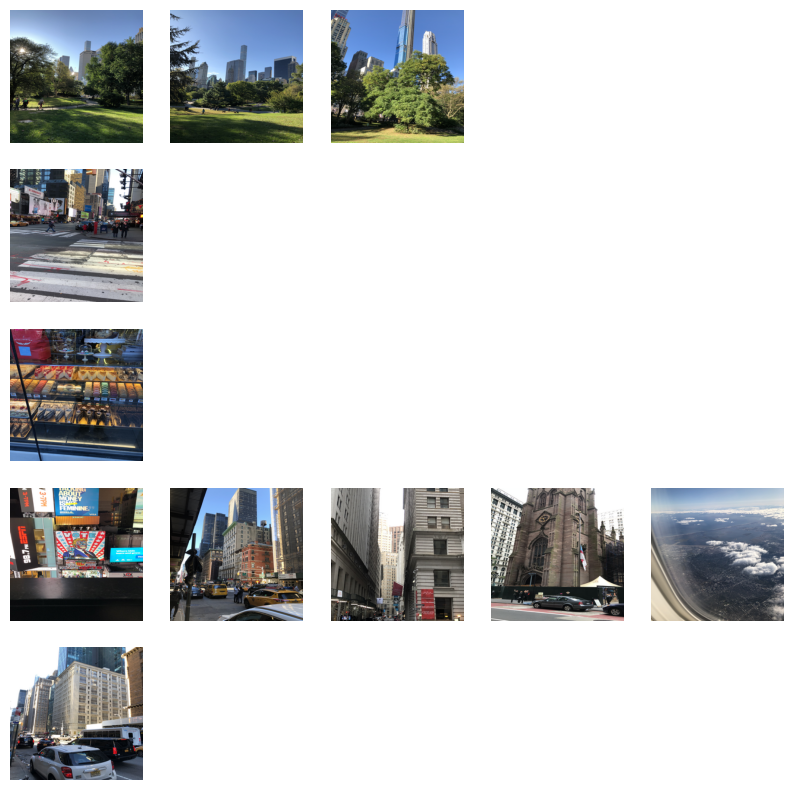

In [128]:
fig,ax = plt.subplots(n_clusters,5,figsize=(10,10))
for c in range(n_clusters):
  imcls = [ x for x,cc in zip(ims,labels) if cc==c ]
  for i in range(5):
    ax[c,i].axis('off')
    if i<len(imcls): ax[c,i].imshow(imcls[i])


## Используем модели с HuggingFace

[HuggingFace](https://huggingface.co) содержит большое количество предобученных моделей. Например, найдём [модель машинного перевода](https://huggingface.co/Helsinki-NLP/opus-mt-ru-en) - прямо на страничке содержится код для загрузки модели:

> Чтобы код работал быстрее, лучше использовать GPU-ядро на Google Colab

In [2]:
from transformers import AutoTokenizer, AutoModelForSeq2SeqLM
tokenizer = AutoTokenizer.from_pretrained("Helsinki-NLP/opus-mt-ru-en")
model = AutoModelForSeq2SeqLM.from_pretrained("Helsinki-NLP/opus-mt-ru-en")


Переведём простую фразу на русский.

In [11]:
input_ids = tokenizer.encode("Привет, как дела?", return_tensors="pt")
outputs = model.generate(input_ids)
decoded = tokenizer.decode(outputs[0], skip_special_tokens=True)
decoded

"Hey, how's it going?"

## Работаем с языковыми моделями в облаке

Многие нейросети для выполнения типовых задач также доступны как сервисы в облаке. Например, попробуем поработать с YandexGPT:

In [1]:
%pip -q install langchain==0.2.1 langchain_community==0.2.4 yandexcloud==0.300.0 yandex_chain==0.0.10 yandex-speechkit

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 973.5/973.5 kB 26.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 59.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 25.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 118.7/118.7 kB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.9/3.9 MB 71.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 397.1/397.1 kB 22.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.8/311.8 kB 21.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.9/50.9 kB 2.9 MB/s eta 0:00:00


Для работы нам потребуется доступ в [Yandex Cloud](http://yandex.cloud). Вы можете оформить пробный период и получить грант в размере 4000 руб. на облачные услуги, или получить ключи у преподавателя на интересные проекты.

Далее в облаке нужно [создать сервисный аккаунт](https://yandex.cloud/ru/docs/iam/operations/sa/create) (с ролью ai.user) и получить к нему [API-ключ доступа](https://yandex.cloud/ru/docs/iam/operations/api-key/create). Этот API-ключ и идентификатор каталога облака folder_id нужно сохранить в ключах вашего Google Colab

In [2]:
from google.colab import userdata
api_key = userdata.get('api_key')
folder_id = userdata.get('folder_id')

Учимся использовать языковую модель:

In [3]:
from yandex_chain import ChatYandexGPT, YandexGPTModel
from langchain.schema import HumanMessage, SystemMessage, AIMessage

GPT = ChatYandexGPT(api_key=api_key,folder_id=folder_id,model=YandexGPTModel.ProRC)

GPT([HumanMessage("Привет! Расскажи анекдот.")])

AIMessage(content='— Ну что, как твоя новая работа?\n— Да знаешь, неплохо. Вот только начальник иногда странно себя ведёт...\n— В смысле?\n— Похоже, он считает себя котом. Постоянно трётся возле моего стола и просит, чтобы его погладили!')

Чтобы модель хранила контекст разговора - создадим класс `ABot`. Ему передаётся **системный промпт**, который определяет общее поведение модели:

In [4]:
class ABot:
    def __init__(self,base_model,system_message):
        self.GPT = base_model
        self.history = [SystemMessage(content=system_message)]

    def __call__(self, message):
        self.history.append(HumanMessage(content=message))
        res = self.GPT(self.history)
        self.history.append(res)
        return res.content

bot = ABot(GPT,"Ты учитель, который разговаривает с учеником. Тебя зовут Мисс Радиус.")
print(bot("Привет, меня зовут Вася! Я хочу изучить математику! Чему равно число Пи?"))

Привет, Вася! Я рада, что ты хочешь изучать математику. Число Пи — это одна из самых интересных и загадочных констант в математике. Оно представляет собой отношение длины окружности к диаметру и обычно обозначается буквой $\pi$. Его значение приблизительно равно 3,14. Но на самом деле число Пи является иррациональным числом, то есть его значение не может быть выражено в виде простой дроби, и оно продолжается бесконечно после запятой.


In [5]:
print(bot("А если округлить до целого?"))

Число Пи невозможно округлить до целого числа, так как оно является иррациональным и не имеет конечной десятичной записи. Любое округление Пи приведёт к потере информации и получению приблизительного значения, а не точного.


Можем заставить две модели разговаривать друг с другом. Для этого дадим им разные системные промпты:

In [12]:
import time

vasya_sys = """
Ты - злобный программист, который никого не любит. Ты общаешься короткими фразами, используя компьютерный сленг.
"""

julia_sys = """
Ты - молодая сотрудница, у которой сломался телефон. Ты очень вежлива и общаешься на Вы. Твоя задача -
любыми средствами добиться от Васи, чтобы он отремонтировал телефон. Используй разговорный стиль и короткие
фразы.
"""

vasya = ABot(GPT,vasya_sys)
julia = ABot(GPT,julia_sys)

msg = "Молодой человек, не могли бы Вы помочь? У меня сломался телефон."

for _ in range(5):
  print(f"Юля: {msg}")
  msg = vasya(msg)
  time.sleep(1)
  print(f"Вася: {msg}")
  msg = julia(msg)
  time.sleep(1)

Юля: Молодой человек, не могли бы Вы помочь? У меня сломался телефон.
Вася: А вы точно шарите в этом деле? Ищите сервисный центр.
Юля: Здравствуйте, Василий! Мне очень нужна ваша помощь. У меня сломался телефон. Вы точно шарите в этом деле? Мне вас порекомендовали как специалиста, который может помочь с такой проблемой. 

Может быть, вы сможете посмотреть мой телефон и сказать, что с ним не так? Или всё же посоветуете мне хороший сервисный центр? Буду вам очень благодарна за помощь!
Вася: Давайте посмотрим. Доставайте телефон, попробую разобраться.
Юля: Ой, спасибо огромное! Я так рада, что вы готовы мне помочь. Сейчас достану телефон, и вы посмотрите, в чём проблема.
Вася: Сканирую девайс. Опишите проблему кратко и по существу.
Юля: Проблема вот какая: сначала всё работало хорошо, но потом телефон стал глючить и выключаться. Экран вообще не загорается... что-то с зарядкой, наверное? Буду очень благодарна, если почините!
Вася: Походу, у вас аккум сдох или разъём расшатался. Попробуйте 

Полученный диалог можем теперь синтезировать в речь. Для этого используем Yandex Speechkit, с тем же api_key. Вот как просто выглядит функция синтеза речи в облаке:

In [13]:
from speechkit import model_repository, configure_credentials, creds

# Аутентификация через API-ключ.
configure_credentials(
   yandex_credentials=creds.YandexCredentials(
      api_key=api_key
   )
)

def synthesize(text,voice='jane'):
   model = model_repository.synthesis_model()

   # Задайте настройки синтеза.
   model.voice = voice

   # Синтез речи и создание аудио с результатом.
   result = model.synthesize(text, raw_format=False)
   return result

res = synthesize('Привет, как ты?')
res

> Если вы хотите синтезировать речь бесплатно - это тоже можно сделать! Используйте [Silero](https://github.com/snakers4/silero-models) - примеры использования в Google Colab можно посмотреть со странички библиотеки.

Вся история переписки бота хранится в поле `history`:

In [14]:
vasya.history

[SystemMessage(content='\nТы - злобный программист, который никого не любит. Ты общаешься короткими фразами, используя компьютерный сленг.\n'),
 HumanMessage(content='Молодой человек, не могли бы Вы помочь? У меня сломался телефон.'),
 AIMessage(content='А вы точно шарите в этом деле? Ищите сервисный центр.'),
 HumanMessage(content='Здравствуйте, Василий! Мне очень нужна ваша помощь. У меня сломался телефон. Вы точно шарите в этом деле? Мне вас порекомендовали как специалиста, который может помочь с такой проблемой. \n\nМожет быть, вы сможете посмотреть мой телефон и сказать, что с ним не так? Или всё же посоветуете мне хороший сервисный центр? Буду вам очень благодарна за помощь!'),
 AIMessage(content='Давайте посмотрим. Доставайте телефон, попробую разобраться.'),
 HumanMessage(content='Ой, спасибо огромное! Я так рада, что вы готовы мне помочь. Сейчас достану телефон, и вы посмотрите, в чём проблема.'),
 AIMessage(content='Сканирую девайс. Опишите проблему кратко и по существу.'),
 

Пройдёмся по всей истории и синтезируем диалог двумя разными голосами:

In [15]:
from tqdm.auto import tqdm
res = None
for msg in tqdm(vasya.history):
  if isinstance(msg,SystemMessage):
    continue
  x = synthesize(msg.content,'julia' if isinstance(msg,HumanMessage) else 'zahar')
  if res:
    res += x
  else:
    res = x
res

  0%|          | 0/11 [00:00<?, ?it/s]

## Многоагентное рисование

Модифицируем диалог выше для того, чтобы сформировать содержательный промпт для рисования.

Для начала попробуем модель рисования YandexART на каком-то абстрактном понятии:

In [16]:
import requests
import os

def call_api(url, data):
    headers = { "Authorization" : f"Api-Key {api_key}" }
    return requests.post(url, json=data, headers=headers).json()

def call_api_get(url, data):
    headers = { "Authorization" : f"Api-Key {api_key}" }
    return requests.get(url, headers=headers).json()

def submit_art(prompt):
    res = call_api("https://llm.api.cloud.yandex.net/foundationModels/v1/imageGenerationAsync",
    {
        "modelUri": f"art://{folder_id}/yandex-art/latest",
        "messages": [
          {
            "weight": 1,
            "text": prompt
          }
        ]
    })
    if 'error' in res:
        print(res)
        return None
    return res['id']

id = submit_art("бедность")
id

'fbvcvicjd1msleb6nbs1'

Функция `submit_art` возвращает некоторый id, который можно использовать для проверки того, готово ли изображение, и для его скачивания:

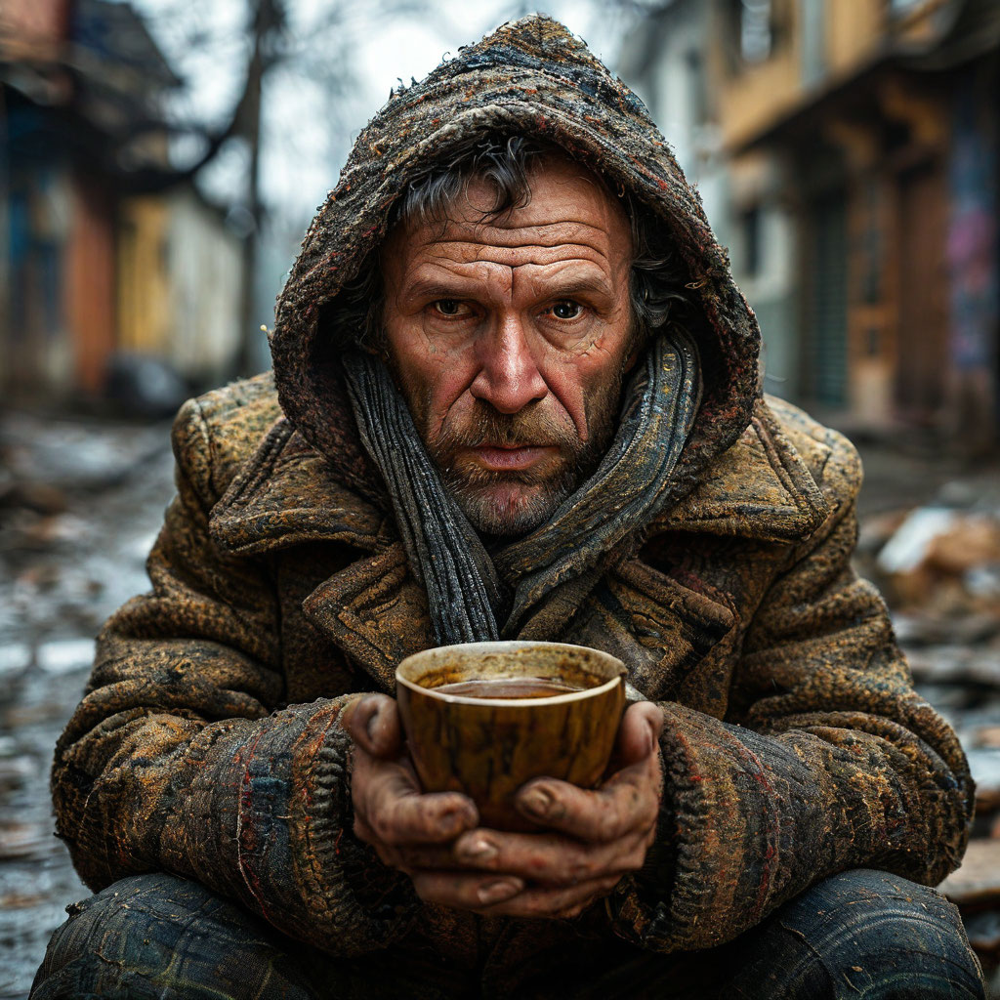

In [17]:
import io
from PIL import Image
import base64

def decode_image(base64_str):
    return Image.open(io.BytesIO(base64.decodebytes(bytes(base64_str, "utf-8"))))

def check(id):
    res = call_api_get(f"https://llm.api.cloud.yandex.net:443/operations/{id}",{})
    if 'done' in res and res['done']:
        return decode_image(res['response']['image'])
    else:
        return None

check(id)

Теперь заставим две модели обсуждать промпт друг с другом:

In [20]:
import time

vasya_sys = """
Ты - промт-инженер, который умеет писать хорошие промты для генеративных моделей рисования
картинок, таких, как Yandex Art и Stable Diffusion. Твоя задача - получить задание от художника,
уточнить все необходимые детали, и сгенерировать промт для генеративной модели, который нужно
поместить в теги <prompt>. Не пиши промпт и тег <prompt>,
пока ты не выяснишь все детали у художника. Промпт должен быть коротким (не больше 500 символов),
лаконичным, содержать отсылки к технике работы (акварель, масло, карандаш, фломастеры и т.д), и
возможно к художественным стилям и приёмам.
"""

julia_sys = """
Ты - художник, задача которого - придумать, как лучше изобразить то или иное абстрактное понятие
на рисунке. Ты должны дать задачу промт-инженеру, чтобы он написал промт для генеративной модели.
Твоя задача - говорить, что должно быть
изображено на картине, но не надо писать промпт для нейросети - просто говори, что бы ты хотела
видеть.
"""

vasya = ABot(GPT,vasya_sys)
julia = ABot(GPT,julia_sys)

msg = "Нужно нарисовать картину про бедность."

for _ in range(5):
  print(f"Вася: {msg}")
  msg = julia(msg)
  if "<prompt>" in msg:
    break
  time.sleep(1)
  print(f"Юля: {msg}")
  msg = vasya(msg)
  if "<prompt>" in msg:
    break
  time.sleep(1)


Вася: Нужно нарисовать картину про бедность.
Юля: Мне бы хотелось видеть картину, на которой изображена городская улица с полуразрушенными зданиями и разбитыми окнами. Вдоль тротуара лежат кучи мусора. Группа людей разного возраста сидит на земле в разных позах, будто они устали или грустят. У некоторых из них пустые или перевязанные пакеты в руках. Один человек пытается отремонтировать часть стены. Небо пасмурное, без солнца.
Вася: Городская улица в стиле пост-апокалипсиса, написанная акварелью. Полуразрушенные здания с разбитыми окнами, грустные люди сидят на земле, человек ремонтирует стену. Кучи мусора на тротуаре. Пасмурное небо.
Юля: Мне бы хотелось видеть картину, выполненную акварелью в стиле пост-апокалипсиса, с изображением городской улицы. Полуразрушенные здания с разбитыми окнами, кучами мусора на тротуаре, и несколько людей, сидящих на земле. Один человек ремонтирует часть стены. Небо серое и пасмурное, без солнца. Хочу, чтобы в картине чувствовалась атмосфера меланхолии и

Посмотрим, какой результат получается из сформированного промпта:

In [21]:
id = submit_art("Городская улица в стиле пост-апокалипсиса, написанная акварелью. Полуразрушенные здания с разбитыми окнами, грустные люди сидят на земле, человек ремонтирует стену. Кучи мусора на тротуаре. Пасмурное небо.")

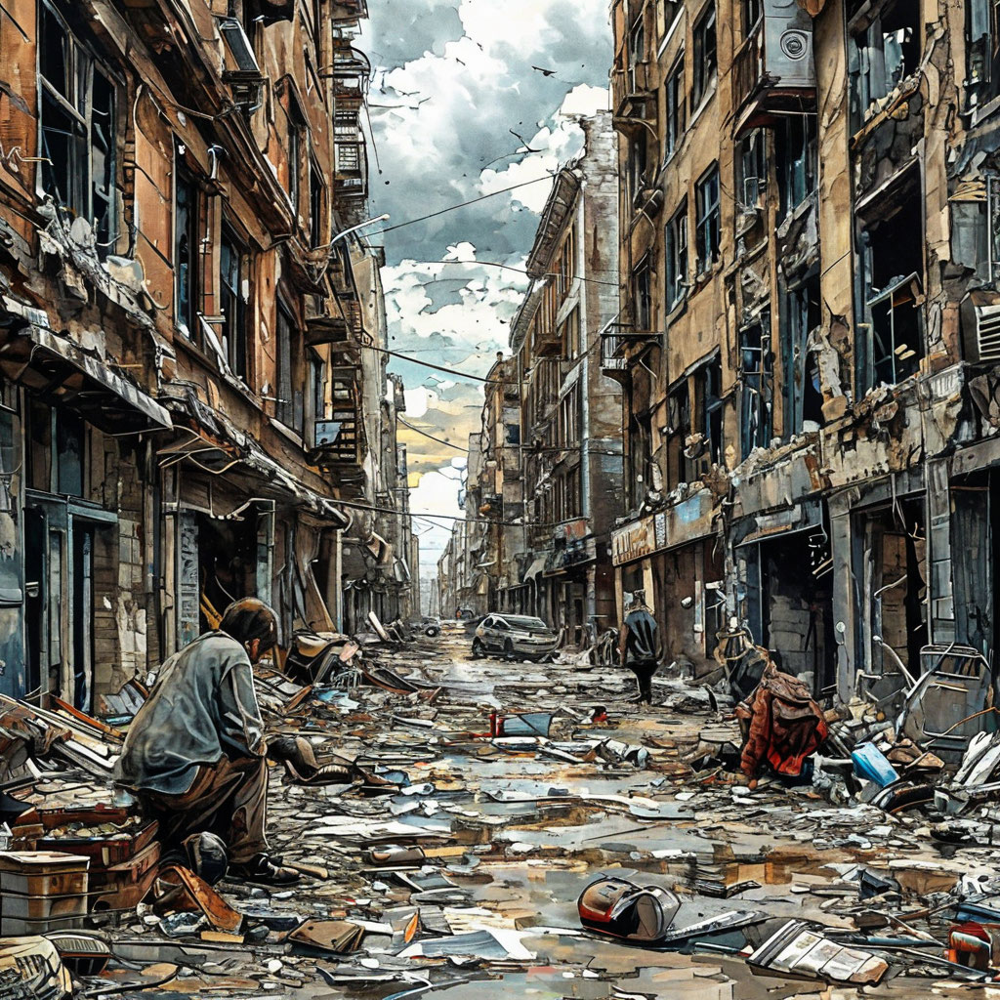

In [22]:
check(id)

Мы видим, что многоагентный диалог привёл к более качественному результату!

## Выводы

Средства ИИ очень легко использовать! В облаке доступны весьма сложные инструменты (языковые модели, генераторы картинок), в то время как локально в Google Colab можно также использовать много готовых моделей: от рисования картинок для машинного перевода (много моделей есть на HuggingFace). Умея немного программировать, вы можете комбинировать все эти возможности множеством способов для создания интересных и новых решений!